In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm
from scipy import stats
from scipy.stats import yeojohnson
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
import warnings
warnings.filterwarnings('ignore', category=FutureWarning, module='seaborn._oldcore')

In [3]:

#from google.colab import drive
#drive.mount('/content/drive')


Mounted at /content/drive


In [4]:
df=pd.read_csv("/content/drive/MyDrive/phising dataset from kaggel not for maine project/Phishing_Legitimate_full.csv")

In [5]:
df

,id,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
0,1,3,1,5,72,0,0,0,0,0,...,0,0,1,1,0,1,1,-1,1,1
1,2,3,1,3,144,0,0,0,0,2,...,0,0,0,1,-1,1,1,1,1,1
2,3,3,1,2,58,0,0,0,0,0,...,0,0,0,1,0,-1,1,-1,0,1
3,4,3,1,6,79,1,0,0,0,0,...,0,0,0,1,-1,1,1,1,-1,1
4,5,3,0,4,46,0,0,0,0,0,...,1,0,0,1,1,-1,0,-1,-1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9996,3,1,1,50,0,0,0,0,0,...,0,0,0,1,1,-1,1,0,1,0
9996,9997,2,1,4,59,1,0,0,0,0,...,1,0,0,1,0,0,1,0,1,0
9997,9998,2,1,4,57,0,0,0,0,0,...,0,0,0,1,0,1,1,0,1,0
9998,9999,3,1,1,49,0,0,0,0,0,...,1,0,0,1,1,0,1,0,1,0


In [6]:
df.head()

,id,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
0,1,3,1,5,72,0,0,0,0,0,...,0,0,1,1,0,1,1,-1,1,1
1,2,3,1,3,144,0,0,0,0,2,...,0,0,0,1,-1,1,1,1,1,1
2,3,3,1,2,58,0,0,0,0,0,...,0,0,0,1,0,-1,1,-1,0,1
3,4,3,1,6,79,1,0,0,0,0,...,0,0,0,1,-1,1,1,1,-1,1
4,5,3,0,4,46,0,0,0,0,0,...,1,0,0,1,1,-1,0,-1,-1,1


In [7]:
df.tail()

,id,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
9995,9996,3,1,1,50,0,0,0,0,0,...,0,0,0,1,1,-1,1,0,1,0
9996,9997,2,1,4,59,1,0,0,0,0,...,1,0,0,1,0,0,1,0,1,0
9997,9998,2,1,4,57,0,0,0,0,0,...,0,0,0,1,0,1,1,0,1,0
9998,9999,3,1,1,49,0,0,0,0,0,...,1,0,0,1,1,0,1,0,1,0
9999,10000,3,1,2,52,3,0,0,0,0,...,0,0,0,1,1,1,1,1,1,0


In [8]:
df.shape

(10000, 50)

In [9]:

df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 50 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   id                                  10000 non-null  int64  
 1   NumDots                             10000 non-null  int64  
 2   SubdomainLevel                      10000 non-null  int64  
 3   PathLevel                           10000 non-null  int64  
 4   UrlLength                           10000 non-null  int64  
 5   NumDash                             10000 non-null  int64  
 6   NumDashInHostname                   10000 non-null  int64  
 7   AtSymbol                            10000 non-null  int64  
 8   TildeSymbol                         10000 non-null  int64  
 9   NumUnderscore                       10000 non-null  int64  
 10  NumPercent                          10000 non-null  int64  
 11  NumQueryComponents                  10000 

In [10]:
 #Name of columns
list(df.columns)

['id',
 'NumDots',
 'SubdomainLevel',
 'PathLevel',
 'UrlLength',
 'NumDash',
 'NumDashInHostname',
 'AtSymbol',
 'TildeSymbol',
 'NumUnderscore',
 'NumPercent',
 'NumQueryComponents',
 'NumAmpersand',
 'NumHash',
 'NumNumericChars',
 'NoHttps',
 'RandomString',
 'IpAddress',
 'DomainInSubdomains',
 'DomainInPaths',
 'HttpsInHostname',
 'HostnameLength',
 'PathLength',
 'QueryLength',
 'DoubleSlashInPath',
 'NumSensitiveWords',
 'EmbeddedBrandName',
 'PctExtHyperlinks',
 'PctExtResourceUrls',
 'ExtFavicon',
 'InsecureForms',
 'RelativeFormAction',
 'ExtFormAction',
 'AbnormalFormAction',
 'PctNullSelfRedirectHyperlinks',
 'FrequentDomainNameMismatch',
 'FakeLinkInStatusBar',
 'RightClickDisabled',
 'PopUpWindow',
 'SubmitInfoToEmail',
 'IframeOrFrame',
 'MissingTitle',
 'ImagesOnlyInForm',
 'SubdomainLevelRT',
 'UrlLengthRT',
 'PctExtResourceUrlsRT',
 'AbnormalExtFormActionR',
 'ExtMetaScriptLinkRT',
 'PctExtNullSelfRedirectHyperlinksRT',
 'CLASS_LABEL']

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 50 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   id                                  10000 non-null  int64  
 1   NumDots                             10000 non-null  int64  
 2   SubdomainLevel                      10000 non-null  int64  
 3   PathLevel                           10000 non-null  int64  
 4   UrlLength                           10000 non-null  int64  
 5   NumDash                             10000 non-null  int64  
 6   NumDashInHostname                   10000 non-null  int64  
 7   AtSymbol                            10000 non-null  int64  
 8   TildeSymbol                         10000 non-null  int64  
 9   NumUnderscore                       10000 non-null  int64  
 10  NumPercent                          10000 non-null  int64  
 11  NumQueryComponents                  10000 

In [12]:
df.describe()

,id,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
count,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,...,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,5000.50000,2.445100,0.586800,3.300300,70.264100,1.818000,0.138900,0.000300,0.013100,0.32320,...,0.339600,0.03220,0.030400,0.956600,0.020200,0.353300,0.793200,0.173400,0.314100,0.500000
std,2886.89568,1.346836,0.751214,1.863241,33.369877,3.106258,0.545744,0.017319,0.113709,1.11466,...,0.473597,0.17654,0.171694,0.248037,0.820036,0.888908,0.521019,0.755771,0.897843,0.500025
min,1.00000,1.000000,0.000000,0.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.00000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0.000000
25%,2500.75000,2.000000,0.000000,2.000000,48.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.00000,0.000000,1.000000,-1.000000,-1.000000,1.000000,0.000000,-1.000000,0.000000
50%,5000.50000,2.000000,1.000000,3.000000,62.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.00000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.500000
75%,7500.25000,3.000000,1.000000,4.000000,84.000000,2.000000,0.000000,0.000000,0.000000,0.00000,...,1.000000,0.00000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,10000.00000,21.000000,14.000000,18.000000,253.000000,55.000000,9.000000,1.000000,1.000000,18.00000,...,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [13]:
df.isnull().sum()

,0
id,0
NumDots,0
SubdomainLevel,0
PathLevel,0
UrlLength,0
NumDash,0
NumDashInHostname,0
AtSymbol,0
TildeSymbol,0
NumUnderscore,0


In [14]:
df.duplicated().sum()

0

In [15]:
# segarted the feature
# cat vs num
categorical_columns=df.columns[df.dtypes=="object"] # cate

In [16]:
categorical_columns

Index([], dtype='object')

In [17]:
numerical_columns=df.columns[df.dtypes!='object']

In [18]:
numerical_columns

Index(['id', 'NumDots', 'SubdomainLevel', 'PathLevel', 'UrlLength', 'NumDash',
       'NumDashInHostname', 'AtSymbol', 'TildeSymbol', 'NumUnderscore',
       'NumPercent', 'NumQueryComponents', 'NumAmpersand', 'NumHash',
       'NumNumericChars', 'NoHttps', 'RandomString', 'IpAddress',
       'DomainInSubdomains', 'DomainInPaths', 'HttpsInHostname',
       'HostnameLength', 'PathLength', 'QueryLength', 'DoubleSlashInPath',
       'NumSensitiveWords', 'EmbeddedBrandName', 'PctExtHyperlinks',
       'PctExtResourceUrls', 'ExtFavicon', 'InsecureForms',
       'RelativeFormAction', 'ExtFormAction', 'AbnormalFormAction',
       'PctNullSelfRedirectHyperlinks', 'FrequentDomainNameMismatch',
       'FakeLinkInStatusBar', 'RightClickDisabled', 'PopUpWindow',
       'SubmitInfoToEmail', 'IframeOrFrame', 'MissingTitle',
       'ImagesOnlyInForm', 'SubdomainLevelRT', 'UrlLengthRT',
       'PctExtResourceUrlsRT', 'AbnormalExtFormActionR', 'ExtMetaScriptLinkRT',
       'PctExtNullSelfRedirectHyperl

In [ ]:


print("Number of Categorical columns: ",len(categorical_columns))
print("Number of Numerical columns: ",len(numerical_columns))


In [19]:
df[numerical_columns].describe().T # transpose

,count,mean,std,min,25%,50%,75%,max
id,10000.0,5000.500000,2886.895680,1.0,2500.750000,5000.500000,7500.250000,10000.0
NumDots,10000.0,2.445100,1.346836,1.0,2.000000,2.000000,3.000000,21.0
SubdomainLevel,10000.0,0.586800,0.751214,0.0,0.000000,1.000000,1.000000,14.0
PathLevel,10000.0,3.300300,1.863241,0.0,2.000000,3.000000,4.000000,18.0
UrlLength,10000.0,70.264100,33.369877,12.0,48.000000,62.000000,84.000000,253.0
NumDash,10000.0,1.818000,3.106258,0.0,0.000000,0.000000,2.000000,55.0
NumDashInHostname,10000.0,0.138900,0.545744,0.0,0.000000,0.000000,0.000000,9.0
AtSymbol,10000.0,0.000300,0.017319,0.0,0.000000,0.000000,0.000000,1.0
TildeSymbol,10000.0,0.013100,0.113709,0.0,0.000000,0.000000,0.000000,1.0
NumUnderscore,10000.0,0.323200,1.114660,0.0,0.000000,0.000000,0.000000,18.0


In [20]:
df.columns

Index(['id', 'NumDots', 'SubdomainLevel', 'PathLevel', 'UrlLength', 'NumDash',
       'NumDashInHostname', 'AtSymbol', 'TildeSymbol', 'NumUnderscore',
       'NumPercent', 'NumQueryComponents', 'NumAmpersand', 'NumHash',
       'NumNumericChars', 'NoHttps', 'RandomString', 'IpAddress',
       'DomainInSubdomains', 'DomainInPaths', 'HttpsInHostname',
       'HostnameLength', 'PathLength', 'QueryLength', 'DoubleSlashInPath',
       'NumSensitiveWords', 'EmbeddedBrandName', 'PctExtHyperlinks',
       'PctExtResourceUrls', 'ExtFavicon', 'InsecureForms',
       'RelativeFormAction', 'ExtFormAction', 'AbnormalFormAction',
       'PctNullSelfRedirectHyperlinks', 'FrequentDomainNameMismatch',
       'FakeLinkInStatusBar', 'RightClickDisabled', 'PopUpWindow',
       'SubmitInfoToEmail', 'IframeOrFrame', 'MissingTitle',
       'ImagesOnlyInForm', 'SubdomainLevelRT', 'UrlLengthRT',
       'PctExtResourceUrlsRT', 'AbnormalExtFormActionR', 'ExtMetaScriptLinkRT',
       'PctExtNullSelfRedirectHyperl

In [21]:
# prompt: find the unique values  in the columns

for col in df.columns:
  print(f"Unique values in column '{col}': {df[col].unique()}")


Unique values in column 'id': [    1     2     3 ...  9998  9999 10000]
Unique values in column 'NumDots': [ 3  2  1  8  5  4  6 12  7 14 13 15 10 16  9 11 21]
Unique values in column 'SubdomainLevel': [ 1  0  7  4  2 11  3  8  6  5 14  9 10]
Unique values in column 'PathLevel': [ 5  3  2  6  4  1 10  7  9  8  0 11 13 14 15 12 18 16]
Unique values in column 'UrlLength': [ 72 144  58  79  46  42  60  30  76  64  47  61  35  73  50  59  28  32
  52  62 105  55 134  43 210 135  85  80  44  95 100 111  29  37  49  34
  53  45  65 182  39  41 142  51  48 129 184 133 120  63  57 153  67  40
 139  70 149 152  82  25 212  68  38  89  90  54 172 164 191  56  33  36
 187  69  83  74  86 123  84  92  97  98  99 104  71 126 127 132  66 136
 128 146 211  26 101  91  78  88  94 216 102 170 242  75 240 103  81 118
 116 199  24  19 162  87 119 205 165  93 121  27  31 106 140 220  77 110
 197 222 249 163 241 168 231 171 215 138 169 252  22 221 236 225 173  96
 226 219 131 112 176 107 248 115 125 114 11

According to the Data descrition, these are the meaning of the values in the data



*  1 means legitimate
*  0 is suspicious
*  -1 is phishing

In [ ]:
# prompt: find the unique values in categorical and numerical columns

# Unique values in categorical columns
for col in categorical_columns:
  print(f"Unique values in column '{col}': {df[col].unique()}")

# Unique values in numerical columns
for col in numerical_columns:
  print(f"Unique values in column '{col}': {df[col].unique()}")


**EDA**    :📈📊📉

Let us drop the index column because that acts as a primary key and has no significance in EDA and modelling

In [22]:
df = df.drop(columns=['id'])

In [70]:
df

,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,NumPercent,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
0,3,1,5,72,0,0,0,0,0,0,...,0,0,1,1,0,1,1,-1,1,1
1,3,1,3,144,0,0,0,0,2,0,...,0,0,0,1,-1,1,1,1,1,1
2,3,1,2,58,0,0,0,0,0,0,...,0,0,0,1,0,-1,1,-1,0,1
3,3,1,6,79,1,0,0,0,0,0,...,0,0,0,1,-1,1,1,1,-1,1
4,3,0,4,46,0,0,0,0,0,0,...,1,0,0,1,1,-1,0,-1,-1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,3,1,1,50,0,0,0,0,0,0,...,0,0,0,1,1,-1,1,0,1,0
9996,2,1,4,59,1,0,0,0,0,0,...,1,0,0,1,0,0,1,0,1,0
9997,2,1,4,57,0,0,0,0,0,0,...,0,0,0,1,0,1,1,0,1,0
9998,3,1,1,49,0,0,0,0,0,0,...,1,0,0,1,1,0,1,0,1,0


In [23]:
! pip install -U ydata-profiling




  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 356.2/356.2 kB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 19.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 32.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 66.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=8cdd4290d7f0e5e88c029f589e03d21e97bc156d234c04548b84ad41a946e1be
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [24]:
from ydata_profiling import ProfileReport
y=ProfileReport(df)

In [25]:
y

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
# prompt: give the  information of  this pandas profling

y.to_file("your_report.html")  # Save the report to an HTML file


/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:363: UserWarning: Try running command: 'pip install --upgrade Pillow' to avoid ValueError
  warnings.warn(


Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Dataset has 257 (2.6%) duplicate rows lets .fix this


In [27]:


df = df.drop_duplicates()


In [28]:
df.duplicated().sum()

0

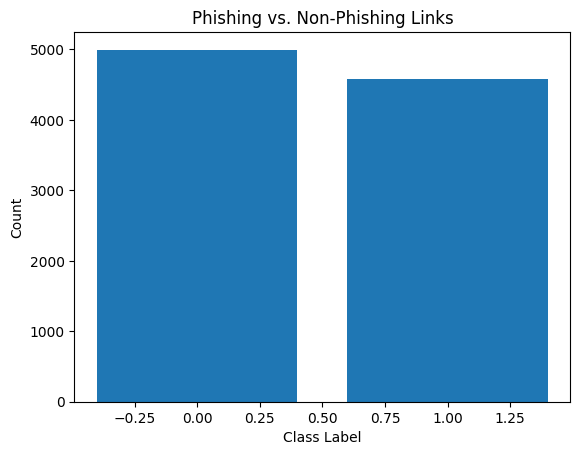

In [29]:
class_counts = df['CLASS_LABEL'].value_counts()

# Create a bar chart
plt.bar(class_counts.index, class_counts.values)

# Add labels and title
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.title('Phishing vs. Non-Phishing Links')

# Add tick labels


# Display the chart
plt.show()

# **Data Summary:**

# * The dataset contains information about phishing and legitimate websites.
# * There are 10000 instances (rows) and 50 features (columns) in the dataset.
# * The target variable is 'CLASS_LABEL', indicating whether a website is phishing (1), suspicious (0), or legitimate (-1).

# **Data Cleaning:**

# * The dataset contains 257 duplicate rows, which have been removed.
# * There are no missing values in the dataset.

# **Exploratory Data Analysis (EDA):**

# * The distribution of class labels shows that the dataset is imbalanced, with more legitimate websites than phishing or suspicious websites.
# * Several numerical features exhibit high correlation, suggesting potential multicollinearity.
# * Some numerical features have a skewed distribution, which might require transformation for certain modeling techniques.

# **Key Insights:**

# * The imbalance in class distribution needs to be addressed during model training to avoid bias towards the majority class.
# * Feature selection or dimensionality reduction techniques could be applied to handle multicollinearity.
# * Data transformation (e.g., log transformation, Yeo-Johnson transformation) might improve model performance for skewed features.
# * Further investigation is needed to understand the specific characteristics of phishing and legitimate websites based on the features provided.

# **Recommendations:**

# * Consider using resampling techniques (oversampling or undersampling) to balance the class distribution.
# * Explore feature selection methods or regularization techniques to address multicollinearity.
# * Experiment with different data transformations to improve model performance.
# * Conduct further analysis to identify the most important features for distinguishing between phishing and legitimate websites.


MODEL BULIDING

In [30]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import StackingClassifier
import xgboost as xgb

In [31]:

X = df.drop('CLASS_LABEL', axis=1) # x = target
y = df['CLASS_LABEL'] # y features


In [32]:
X

,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,NumPercent,...,SubmitInfoToEmail,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT
0,3,1,5,72,0,0,0,0,0,0,...,0,0,0,1,1,0,1,1,-1,1
1,3,1,3,144,0,0,0,0,2,0,...,0,0,0,0,1,-1,1,1,1,1
2,3,1,2,58,0,0,0,0,0,0,...,0,0,0,0,1,0,-1,1,-1,0
3,3,1,6,79,1,0,0,0,0,0,...,1,0,0,0,1,-1,1,1,1,-1
4,3,0,4,46,0,0,0,0,0,0,...,0,1,0,0,1,1,-1,0,-1,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,3,1,1,50,0,0,0,0,0,0,...,0,0,0,0,1,1,-1,1,0,1
9996,2,1,4,59,1,0,0,0,0,0,...,0,1,0,0,1,0,0,1,0,1
9997,2,1,4,57,0,0,0,0,0,0,...,0,0,0,0,1,0,1,1,0,1
9998,3,1,1,49,0,0,0,0,0,0,...,0,1,0,0,1,1,0,1,0,1


In [33]:
y

,CLASS_LABEL
0,1
1,1
2,1
3,1
4,1
5,1
6,1
7,1
8,1
9,1


In [34]:
# prompt: find all the festure columns

feature_columns = X.columns
print(feature_columns)


Index(['NumDots', 'SubdomainLevel', 'PathLevel', 'UrlLength', 'NumDash',
       'NumDashInHostname', 'AtSymbol', 'TildeSymbol', 'NumUnderscore',
       'NumPercent', 'NumQueryComponents', 'NumAmpersand', 'NumHash',
       'NumNumericChars', 'NoHttps', 'RandomString', 'IpAddress',
       'DomainInSubdomains', 'DomainInPaths', 'HttpsInHostname',
       'HostnameLength', 'PathLength', 'QueryLength', 'DoubleSlashInPath',
       'NumSensitiveWords', 'EmbeddedBrandName', 'PctExtHyperlinks',
       'PctExtResourceUrls', 'ExtFavicon', 'InsecureForms',
       'RelativeFormAction', 'ExtFormAction', 'AbnormalFormAction',
       'PctNullSelfRedirectHyperlinks', 'FrequentDomainNameMismatch',
       'FakeLinkInStatusBar', 'RightClickDisabled', 'PopUpWindow',
       'SubmitInfoToEmail', 'IframeOrFrame', 'MissingTitle',
       'ImagesOnlyInForm', 'SubdomainLevelRT', 'UrlLengthRT',
       'PctExtResourceUrlsRT', 'AbnormalExtFormActionR', 'ExtMetaScriptLinkRT',
       'PctExtNullSelfRedirectHyperlinksRT

In [35]:


target_column = 'CLASS_LABEL'
print(target_column)


CLASS_LABEL


In [36]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.33, random_state=42)


In [37]:
X_train

,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,NumPercent,...,SubmitInfoToEmail,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT
1258,3,1,5,67,0,0,0,0,0,0,...,0,0,0,0,1,0,-1,1,-1,1
3926,3,1,3,54,2,0,0,0,0,0,...,0,0,0,0,1,0,-1,1,-1,0
5735,1,0,4,130,13,0,0,0,0,0,...,0,1,0,0,1,-1,0,1,0,0
1979,2,0,4,50,0,0,0,0,0,0,...,0,0,0,1,1,1,1,1,1,-1
7692,3,1,7,104,4,0,0,0,0,0,...,0,1,0,0,1,-1,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6153,1,0,5,121,8,0,0,0,2,0,...,0,0,0,0,1,-1,0,-1,0,1
5610,1,0,2,77,6,0,0,0,0,0,...,0,0,0,0,1,-1,-1,0,0,0
5809,2,1,5,140,8,0,0,0,2,0,...,0,1,0,0,1,-1,-1,1,0,1
923,2,1,3,58,1,1,0,0,0,0,...,0,0,0,0,1,0,1,1,1,-1


In [38]:
from sklearn.linear_model import LinearRegression

In [39]:
linear_model=LinearRegression()

In [40]:
linear_model.fit(X_train, y_train)

LinearRegression()

In [41]:


y_pred_lr = linear_model.predict(X_test)
# Convert predictions to classes
y_pred_classes = [1 if pred >= 0.5 else 0 for pred in y_pred_lr]
print(classification_report(y_test, y_pred_classes))
print("Accuracy Score of Linear Regression is : ", accuracy_score(y_test, y_pred_classes))


              precision    recall  f1-score   support

           0       0.95      0.94      0.94      1631
           1       0.93      0.94      0.94      1531

    accuracy                           0.94      3162
   macro avg       0.94      0.94      0.94      3162
weighted avg       0.94      0.94      0.94      3162

Accuracy Score of Linear Regression is :  0.939595192915876


In [42]:


from sklearn.preprocessing import PowerTransformer
pt = PowerTransformer()
X_train_transformed = pt.fit_transform(X_train)
X_test_transformed = pt.transform(X_test)

linear_model_transformed = LinearRegression()
linear_model_transformed.fit(X_train_transformed, y_train)

y_pred_lr_transformed = linear_model_transformed.predict(X_test_transformed)
# Convert predictions to classes
y_pred_classes_transformed = [1 if pred >= 0.5 else 0 for pred in y_pred_lr_transformed]
print(classification_report(y_test, y_pred_classes_transformed))
print("Accuracy Score of Transformed Linear Regression is : ", accuracy_score(y_test, y_pred_classes_transformed))


              precision    recall  f1-score   support

           0       0.94      0.94      0.94      1631
           1       0.94      0.94      0.94      1531

    accuracy                           0.94      3162
   macro avg       0.94      0.94      0.94      3162
weighted avg       0.94      0.94      0.94      3162

Accuracy Score of Transformed Linear Regression is :  0.9392789373814042


# LogisticRegression

In [43]:
from sklearn.linear_model import LogisticRegression

In [44]:
lr_model=LogisticRegression()

In [45]:
lr_model.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [46]:

y_pred_lr = lr_model.predict(X_test)
print(classification_report(y_test, y_pred_lr))
print("Accuracy Score of Logistic Regression is : ", accuracy_score(y_test, y_pred_lr))


              precision    recall  f1-score   support

           0       0.93      0.93      0.93      1631
           1       0.93      0.93      0.93      1531

    accuracy                           0.93      3162
   macro avg       0.93      0.93      0.93      3162
weighted avg       0.93      0.93      0.93      3162

Accuracy Score of Logistic Regression is :  0.9323213156230234


In [47]:
# tranformation

pt = PowerTransformer()
X_train_transformed = pt.fit_transform(X_train)
X_test_transformed = pt.transform(X_test)

# LogisticRegression
lr_model_transformed = LogisticRegression()
lr_model_transformed.fit(X_train_transformed, y_train)

y_pred_lr_transformed = lr_model_transformed.predict(X_test_transformed)
print(classification_report(y_test, y_pred_lr_transformed))
print("Accuracy Score of Transformed Logistic Regression is : ", accuracy_score(y_test, y_pred_lr_transformed))


              precision    recall  f1-score   support

           0       0.95      0.96      0.95      1631
           1       0.95      0.94      0.95      1531

    accuracy                           0.95      3162
   macro avg       0.95      0.95      0.95      3162
weighted avg       0.95      0.95      0.95      3162

Accuracy Score of Transformed Logistic Regression is :  0.948450347881088


In [48]:
from sklearn.tree import DecisionTreeClassifier

In [49]:
dt_model = DecisionTreeClassifier()

In [50]:
dt_model.fit(X_train, y_train)

DecisionTreeClassifier()

In [51]:
y_pred_dt = dt_model.predict(X_test)
print(classification_report(y_test, y_pred_dt))
print("Accuracy Score of DecisionTreeClassifier : ", accuracy_score(y_test, y_pred_dt))


              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1631
           1       0.96      0.97      0.97      1531

    accuracy                           0.97      3162
   macro avg       0.97      0.97      0.97      3162
weighted avg       0.97      0.97      0.97      3162

Accuracy Score of DecisionTreeClassifier :  0.9683744465528147


In [52]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import StackingClassifier
import xgboost as xgb

In [53]:
# Splitting the data into features and target
target = df['CLASS_LABEL']
features = df.drop(['CLASS_LABEL', 'RelativeFormAction', 'DoubleSlashInPath', 'HttpsInHostname', 'DomainInSubdomains', 'FakeLinkInStatusBar',
                    'RandomString', 'EmbeddedBrandName', 'AtSymbol', 'ImagesOnlyInForm', 'NumHash', 'AbnormalFormAction', 'UrlLengthRT', 'PctExtResourceUrlsRT',
                    'PopUpWindow', 'RightClickDisabled', 'IpAddress', 'SubdomainLevelRT', 'TildeSymbol'], axis=1)

In [54]:
# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

In [55]:
# Creating and fitting the models
xgb_model = xgb.XGBClassifier()
dt_model = DecisionTreeClassifier()
rf_model = RandomForestClassifier()
lr_model = LogisticRegression()
gb_model = GradientBoostingClassifier()
ab_model = AdaBoostClassifier()
svm_model = SVC()
knn_model = KNeighborsClassifier()
gnb_model = GaussianNB()

In [56]:
# Fitting the models
xgb_model.fit(X_train, y_train)
dt_model.fit(X_train, y_train)
rf_model.fit(X_train, y_train)
lr_model.fit(X_train, y_train)
gb_model.fit(X_train, y_train)
ab_model.fit(X_train, y_train)
svm_model.fit(X_train, y_train)
knn_model.fit(X_train, y_train)
gnb_model.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


GaussianNB()

In [57]:
# Making predictions
xgb_pred = xgb_model.predict(X_test)
dt_pred = dt_model.predict(X_test)
rf_pred = rf_model.predict(X_test)
lr_pred = lr_model.predict(X_test)
gb_pred = gb_model.predict(X_test)
ab_pred = ab_model.predict(X_test)
svm_pred = svm_model.predict(X_test)
knn_pred = knn_model.predict(X_test)
gnb_pred = gnb_model.predict(X_test)

In [58]:
# Evaluating the models
xgb_accuracy = accuracy_score(y_test, xgb_pred)
dt_accuracy = accuracy_score(y_test, dt_pred)
rf_accuracy = accuracy_score(y_test, rf_pred)
lr_accuracy = accuracy_score(y_test, lr_pred)
gb_accuracy = accuracy_score(y_test, gb_pred)
ab_accuracy = accuracy_score(y_test, ab_pred)
svm_accuracy = accuracy_score(y_test, svm_pred)
knn_accuracy = accuracy_score(y_test, knn_pred)
gnb_accuracy = accuracy_score(y_test, gnb_pred)

In [78]:
print("XGBoost Accuracy:", xgb_accuracy)
print("Decision Tree Accuracy:", dt_accuracy)
print("Random Forest Accuracy:", rf_accuracy)
print("Logistic Regression Accuracy:", lr_accuracy)
print("Gradient Boosting Accuracy:", gb_accuracy)
print("AdaBoost Accuracy:", ab_accuracy)
print("SVM Accuracy:", svm_accuracy)
print("KNN Accuracy:", knn_accuracy)
print("GaussianNB Accuracy:", gnb_accuracy)

XGBoost Accuracy: 0.9859154929577465
Decision Tree Accuracy: 0.9697443922796035
Random Forest Accuracy: 0.9848721961398018
Logistic Regression Accuracy: 0.936358894105373
Gradient Boosting Accuracy: 0.980699008868023
AdaBoost Accuracy: 0.9744392279603548
SVM Accuracy: 0.8581116327595201
KNN Accuracy: 0.8591549295774648
GaussianNB Accuracy: 0.8544600938967136


In [60]:
import matplotlib.pyplot as plt

# Create a list of models and their corresponding accuracy scores
models = ['XGBoost', 'Decision Tree', 'Random Forest', 'Logistic Regression', 'Gradient Boosting', 'AdaBoost', 'SVM', 'KNN', 'GaussianNB']
train_accuracies = [xgb_model.score(X_train, y_train), dt_model.score(X_train, y_train), rf_model.score(X_train, y_train), lr_model.score(X_train, y_train),
                    gb_model.score(X_train, y_train), ab_model.score(X_train, y_train), svm_model.score(X_train, y_train), knn_model.score(X_train, y_train),
                    gnb_model.score(X_train, y_train)]
test_accuracies = [xgb_accuracy, dt_accuracy, rf_accuracy, lr_accuracy, gb_accuracy, ab_accuracy, svm_accuracy, knn_accuracy, gnb_accuracy]


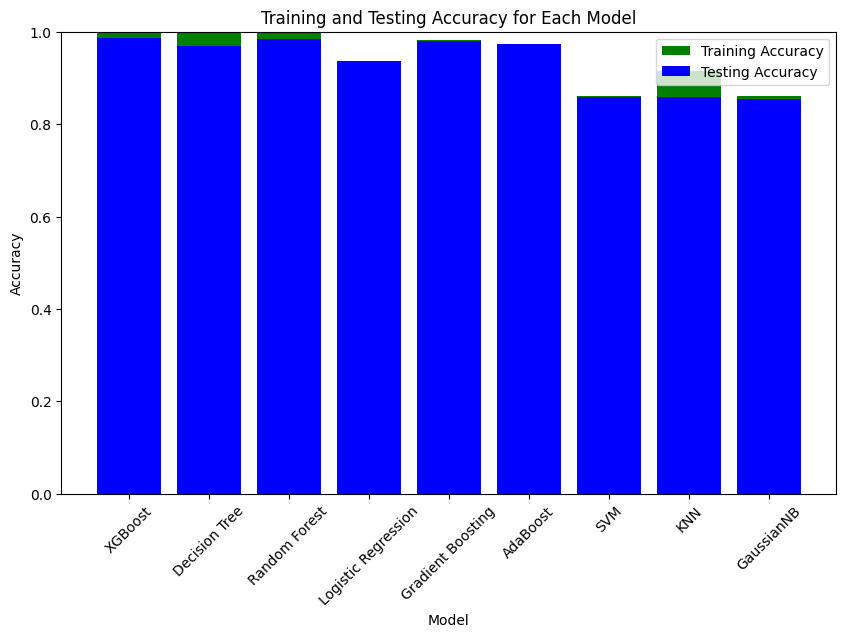

In [61]:
 #Plot the training and testing accuracy for each model
plt.figure(figsize=(10, 6))
plt.bar(models, train_accuracies, color='green', label='Training Accuracy')
plt.bar(models, test_accuracies, color='blue', label='Testing Accuracy')
plt.xlabel('Model')
plt.ylabel('Accuracy')
plt.title('Training and Testing Accuracy for Each Model')
plt.ylim([0, 1])
plt.xticks(rotation=45)
plt.legend()
plt.show()

In [62]:
import matplotlib.pyplot as plt

# Create a list of models and their corresponding accuracy scores
models = ['XGBoost', 'Decision Tree', 'Random Forest', 'Logistic Regression', 'Gradient Boosting', 'AdaBoost', 'SVM', 'KNN', 'GaussianNB']
train_accuracies = [xgb_model.score(X_train, y_train), dt_model.score(X_train, y_train), rf_model.score(X_train, y_train),
                    lr_model.score(X_train, y_train), gb_model.score(X_train, y_train), ab_model.score(X_train, y_train), svm_model.score(X_train, y_train),
                    knn_model.score(X_train, y_train), gnb_model.score(X_train, y_train)]
test_accuracies = [xgb_accuracy, dt_accuracy, rf_accuracy, lr_accuracy, gb_accuracy, ab_accuracy, svm_accuracy, knn_accuracy, gnb_accuracy]


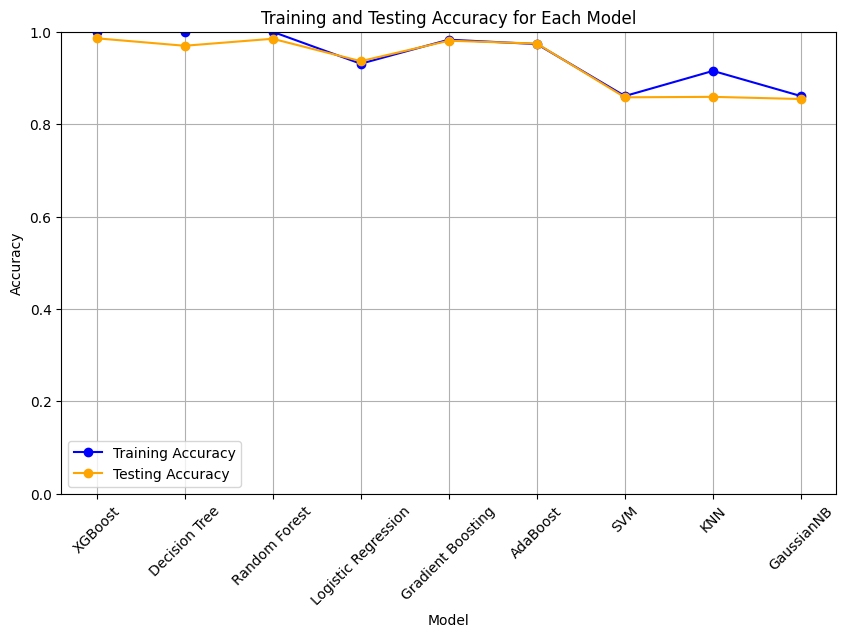

In [63]:
# Plot the training and testing accuracy for each model
plt.figure(figsize=(10, 6))
plt.plot(models, train_accuracies, marker='o', linestyle='-', color='blue', label='Training Accuracy')
plt.plot(models, test_accuracies, marker='o', linestyle='-', color='orange', label='Testing Accuracy')
plt.xlabel('Model')
plt.ylabel('Accuracy')
plt.title('Training and Testing Accuracy for Each Model')
plt.ylim([0, 1])
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

In [64]:
# Stacking Classifier
estimators = [('xgb', xgb_model), ('dt', dt_model), ('rf', rf_model)]
stacking_model = StackingClassifier(estimators=estimators, final_estimator=lr_model)
stacking_model.fit(X_train, y_train)
stacking_pred = stacking_model.predict(X_test)
stacking_accuracy = accuracy_score(y_test, stacking_pred)
print("Stacking Classifier Accuracy:", stacking_accuracy)

Stacking Classifier Accuracy: 0.9869587897756912


In [65]:
# Voting Classifier
voting_model = VotingClassifier(estimators=estimators)
voting_model.fit(X_train, y_train)
voting_pred = voting_model.predict(X_test)
voting_accuracy = accuracy_score(y_test, voting_pred)
print("Voting Classifier Accuracy:", voting_accuracy)

Voting Classifier Accuracy: 0.983828899321857


In [66]:
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix
import matplotlib.pyplot as plt

# Define a list of models and their corresponding predictions
models = ['XGBoost', 'Decision Tree', 'Random Forest', 'Logistic Regression', 'Gradient Boosting', 'AdaBoost', 'SVM', 'KNN', 'GaussianNB',
          'Stacking Classifier', 'Voting Classifier']
predictions = [xgb_pred, dt_pred, rf_pred, lr_pred, gb_pred, ab_pred, svm_pred, knn_pred, gnb_pred, stacking_pred, voting_pred]

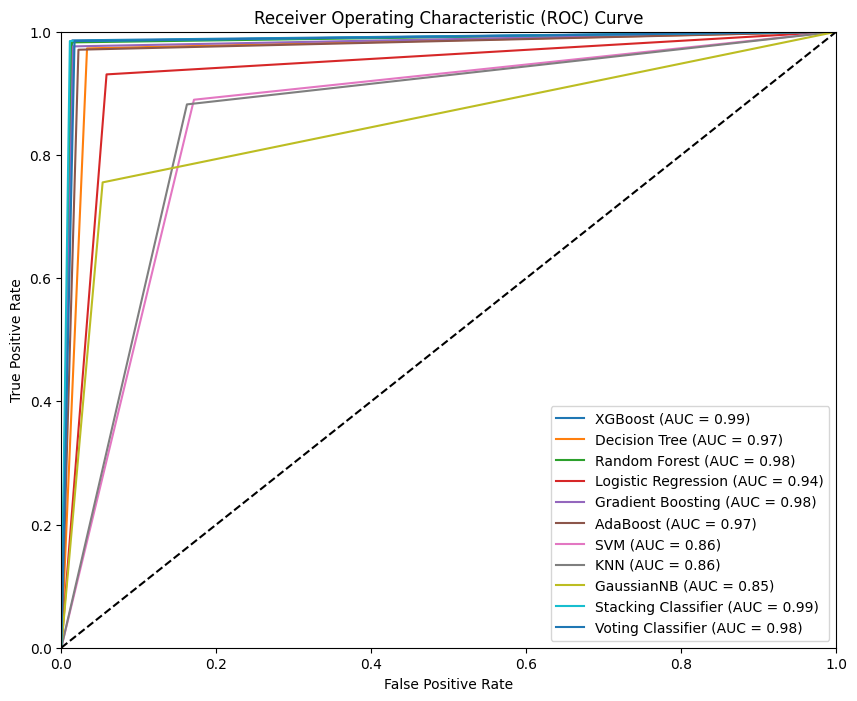

In [67]:
# Plot ROC curves for each model
plt.figure(figsize=(10, 8))
for model, prediction in zip(models, predictions):
    fpr, tpr, _ = roc_curve(y_test, prediction)
    auc = roc_auc_score(y_test, prediction)
    plt.plot(fpr, tpr, label=model + ' (AUC = {:.2f})'.format(auc))

plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()

In [68]:
# Print confusion matrix report for each model
for model, prediction in zip(models, predictions):
    cm = confusion_matrix(y_test, prediction)
    tn, fp, fn, tp = cm.ravel()
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f1_score = 2 * precision * recall / (precision + recall)

    print("Model:", model)
    print("Confusion Matrix:")
    print(cm)
    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Recall:", recall)
    print("F1 Score:", f1_score)
    print("------------------------------")

Model: XGBoost
Confusion Matrix:
[[979  14]
 [ 13 911]]
Accuracy: 0.9859154929577465
Precision: 0.9848648648648649
Recall: 0.9859307359307359
F1 Score: 0.9853975121687398
------------------------------
Model: Decision Tree
Confusion Matrix:
[[960  33]
 [ 25 899]]
Accuracy: 0.9697443922796035
Precision: 0.9645922746781116
Recall: 0.9729437229437229
F1 Score: 0.96875
------------------------------
Model: Random Forest
Confusion Matrix:
[[980  13]
 [ 16 908]]
Accuracy: 0.9848721961398018
Precision: 0.9858849077090119
Recall: 0.9826839826839827
F1 Score: 0.9842818428184281
------------------------------
Model: Logistic Regression
Confusion Matrix:
[[935  58]
 [ 64 860]]
Accuracy: 0.936358894105373
Precision: 0.9368191721132898
Recall: 0.9307359307359307
F1 Score: 0.9337676438653638
------------------------------
Model: Gradient Boosting
Confusion Matrix:
[[978  15]
 [ 22 902]]
Accuracy: 0.980699008868023
Precision: 0.9836423118865867
Recall: 0.9761904761904762
F1 Score: 0.9799022270505161


In [69]:
# Create a DataFrame from the metrics
df_metrics = pd.DataFrame(model_metrics, columns=['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score'])

# Sort the DataFrame by accuracy in descending order
df_metrics_sorted = df_metrics.sort_values(by='Accuracy', ascending=False)

# Display the sorted table
print(df_metrics_sorted)

NameError: name 'model_metrics' is not defined